<a href="https://colab.research.google.com/github/akhiilkasare/Predicting-Future-Terrorist-Activities-Using-Machine-Learning/blob/main/Prediction_of_Future_Terrorist_Activities(Data_Analysis).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from IPython.display import Image
from IPython.core.display import HTML 
Image(url= "https://www.orfonline.org/wp-content/uploads/2016/09/Terrorism-1280x720.jpg")

In [ ]:
import pandas as pd
import numpy as np

import plotly.offline as py
import plotly.graph_objs as go
import matplotlib.pyplot as plt
import seaborn as sns

import plotly.graph_objs as go
import plotly.express as px
import plotly.tools as tls
import plotly.figure_factory as ff
%matplotlib inline

pd.set_option('display.max_columns', None)

import warnings
warnings.filterwarnings('ignore')

/home/akhil/.local/lib/python3.7/site-packages/statsmodels/tools/_testing.py:19: FutureWarning:

pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.



* iyear - This field contains the year in which the incident occurred
* imonth - This field contains the number of the month in which the incident occurred
* iday - This field contains the numeric day of the month on which the incident occurred
* Extended - “Yes,” the duration of an incident extended more than 24 hours “No,” the duration of an      incident extended less than 24 hours
* Provstate - Name (at the time of event) of the 1st order subnational administrative region
* Latitude - The latitude of the city in which the event occurred
* Longitude - The longitude of the city in which the event occurred
* Vicinity - The region in nearby location
* Natlty1 - The nationality of the target that was attacked
* Ishostkid - The hostage of kids
* Country - This field identifies the country or location where the incident occurred
* City - Name of the city, village, or town in which the incident occurred
* Gname - The name of the group that carried out the attack
* Nkillus - The number of U.S. citizens who died as a result of the incident
* Nwound - Number of confirmed nonfatal injuries to both perpetrators and victims
* Nwoundus - The number of confirmed nonfatal injuries to U.S. citizens, both perpetrators and victims
* Property - The damage to property
* Targtype1 - The general type of target/victim
* Suicide -  1 = “Yes,” the incident was a suicide attack; 0 = “No,” there is no indication that the incident was a suicide attack
* Success - Success of a terrorist strike
* Weaptype1 - General type of weapon used in the incident
* Region - This field identifies the region code based on 12 regions
* Attacktype1 - The general method of attack and broad class of tactics used

In [ ]:
col_list = ['iyear', 'imonth','iday','extended','provstate','latitude','longitude','specificity','vicinity','crit1','crit2','crit3','doubtterr',
'multiple', 'natlty1','propextent','ishostkid','ransom','country','city','gname','individual','nkillus','nkillter','nwound','nwoundus',
'nwoundte','property','targtype1','suicide','success','weaptype1','region','attacktype1', 'nkill', 'country_txt']

df = pd.read_excel('globalterrorismdb_0919dist.xlsx', usecols=col_list)

In [ ]:
df.head()

,iyear,imonth,iday,extended,country,country_txt,region,provstate,city,latitude,longitude,specificity,vicinity,crit1,crit2,crit3,doubtterr,multiple,success,suicide,attacktype1,targtype1,natlty1,gname,individual,weaptype1,nkill,nkillus,nkillter,nwound,nwoundus,nwoundte,property,propextent,ishostkid,ransom
0,1970,7,2,0,58,Dominican Republic,2,National,Santo Domingo,18.456792,-69.951164,1.0,0,1,1,1,0,0,1,0,1,14,58.0,MANO-D,0,13,1.0,NaN,NaN,0.0,NaN,NaN,0,NaN,0.0,0.0
1,1970,0,0,0,130,Mexico,1,Federal,Mexico city,19.371887,-99.086624,1.0,0,1,1,1,0,0,1,0,6,7,21.0,23rd of September Communist League,0,13,0.0,NaN,NaN,0.0,NaN,NaN,0,NaN,1.0,1.0
2,1970,1,0,0,160,Philippines,5,Tarlac,Unknown,15.478598,120.599741,4.0,0,1,1,1,0,0,1,0,1,10,217.0,Unknown,0,13,1.0,NaN,NaN,0.0,NaN,NaN,0,NaN,0.0,0.0
3,1970,1,0,0,78,Greece,8,Attica,Athens,37.997490,23.762728,1.0,0,1,1,1,0,0,1,0,3,7,217.0,Unknown,0,6,NaN,NaN,NaN,NaN,NaN,NaN,1,NaN,0.0,0.0
4,1970,1,0,0,101,Japan,4,Fukouka,Fukouka,33.580412,130.396361,1.0,0,1,1,1,-9,0,1,0,7,7,217.0,Unknown,0,8,NaN,NaN,NaN,NaN,NaN,NaN,1,NaN,0.0,0.0


In [ ]:
df.describe(include = 'O')

,country_txt,provstate,city,gname
count,191464,191462,191038,191464
unique,205,2579,39488,3617
top,Iraq,Baghdad,Unknown,Unknown
freq,26057,7832,10298,86261


### Checking the Categorical Columns

In [ ]:
categorical_col = []
for column in df.columns:
    if df[column].dtype == object and len(df[column].unique()) <= 50:
        categorical_col.append(column)
        print(f"{column} : {df[column].unique()}")
        print("====================================")

### Checking for Numerical Columns

In [ ]:
numerical_col = []
for column in df.columns:
    if df[column].dtype != object and len(df[column].unique()) <= 50:
        numerical_col.append(column)
        print(f"{column} : {df[column].unique()}")
        print("====================================")

iyear : [1970 1971 1972 1973 1974 1975 1976 1977 1978 1979 1980 1981 1986 1982
 1983 1984 1985 1987 1988 1989 1990 1991 1992 1994 1995 1996 1997 1998
 1999 2000 2001 2002 2003 2004 2005 2006 2007 2008 2009 2010 2011 2012
 2013 2014 2015 2016 2017 2018]
imonth : [ 7  0  1  2  3  4  5  6  8  9 10 11 12]
iday : [ 2  0  1  3  6  8  9 10 11 12 13 14 15 19 20 21 22 25 26 27 28 30 31  4
  7 16 17 18 23 24  5 29]
extended : [0 1]
region : [ 2  1  5  8  4  3  9 11 10 12  6  7]
specificity : [ 1.  4.  5.  2.  3. nan]
vicinity : [ 0  1 -9]
crit1 : [1 0]
crit2 : [1 0]
crit3 : [1 0]
doubtterr : [ 0 -9  1]
multiple : [0 1]
success : [1 0]
suicide : [0 1]
attacktype1 : [1 6 3 7 2 4 9 8 5]
targtype1 : [14  7 10  3 21  4  2  6  1  8 22 15 20 19 18 12 16  9 17 13 11  5]
individual : [0 1]
weaptype1 : [13  6  8  5  2  9 11 10  7  3 12  1]
nkillus : [      nan 0.000e+00 2.000e+00 1.000e+00 4.000e+00 3.000e+00 8.000e+00
 7.000e+00 3.000e+01 1.100e+01 5.000e+00 1.700e+01 2.410e+02 6.000e+00
 3.100e+01 1.890

In [ ]:
print("The shape of the dataset is :",df.shape)

The shape of the dataset is : (191464, 36)


In [ ]:
df.columns

Index(['iyear', 'imonth', 'iday', 'extended', 'country', 'country_txt',
       'region', 'provstate', 'city', 'latitude', 'longitude', 'specificity',
       'vicinity', 'crit1', 'crit2', 'crit3', 'doubtterr', 'multiple',
       'success', 'suicide', 'attacktype1', 'targtype1', 'natlty1', 'gname',
       'individual', 'weaptype1', 'nkill', 'nkillus', 'nkillter', 'nwound',
       'nwoundus', 'nwoundte', 'property', 'propextent', 'ishostkid',
       'ransom'],
      dtype='object')

In [ ]:
df.suicide.value_counts()

0    184453
1      7011
Name: suicide, dtype: int64

### Checking for missing values

In [ ]:
pd.DataFrame(round(df.isnull().sum()/df.shape[0] * 100,3), columns = ['Missing'])

,Missing
iyear,0.000
imonth,0.000
iday,0.000
extended,0.000
country,0.000
country_txt,0.000
region,0.000
provstate,0.001
city,0.222
latitude,2.392


<AxesSubplot:>

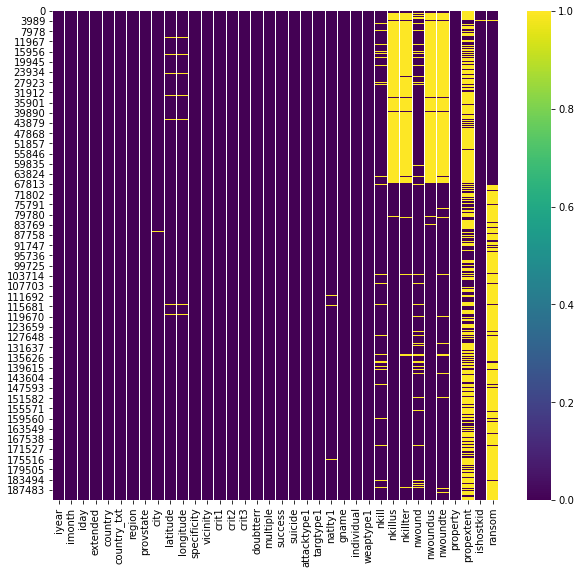

In [ ]:
plt.figure(figsize=(10,9))
sns.heatmap(df.isnull(), cmap='viridis')

In [ ]:
percent_missing = df.isnull().sum() * 100 / len(df)
missing_value_df = pd.DataFrame({'column_name': df.columns,
                                 'percent_missing': percent_missing})

In [ ]:
missing_value_df.sort_values('percent_missing', inplace=True)

In [ ]:
missing_value_df

,column_name,percent_missing
iyear,iyear,0.000000
property,property,0.000000
weaptype1,weaptype1,0.000000
individual,individual,0.000000
gname,gname,0.000000
targtype1,targtype1,0.000000
attacktype1,attacktype1,0.000000
suicide,suicide,0.000000
success,success,0.000000
doubtterr,doubtterr,0.000000


### Checking the Destructive Stats of the Dataset

In [ ]:
print("Country with the most attacks:",df['country_txt'].value_counts().idxmax())
print("City with the most attacks:",df['city'].value_counts().index[1]) #as first entry is 'unknown'
print("Region with the most attacks:",df['region'].value_counts().idxmax())
print("Year with the most attacks:",df['iyear'].value_counts().idxmax())
print("Month with the most attacks:",df['imonth'].value_counts().idxmax(), "(May)")
print("Group with the most attacks:",df['gname'].value_counts().index[1])
print("Most Attack Types:",df['attacktype1'].value_counts().idxmax())

Country with the most attacks: Iraq
City with the most attacks: Baghdad
Region with the most attacks: The Middle East and North Africa
Year with the most attacks: 2014
Month with the most attacks: 5 (May)
Group with the most attacks: Taliban
Most Attack Types: Bombing/explosion


### Number of Terrorist Activities Each Year

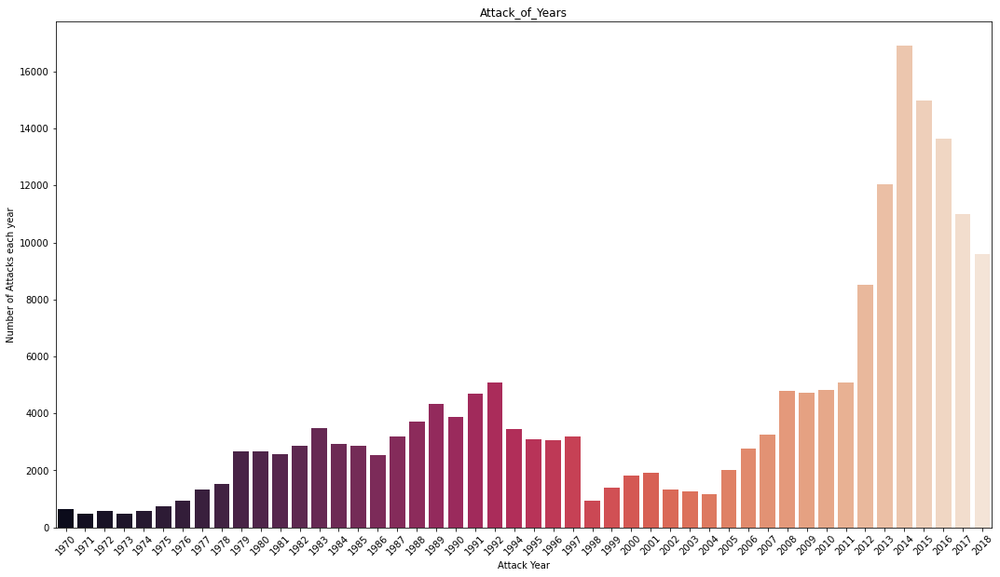

In [ ]:
x_year = df['iyear'].unique()
y_count_years = df['iyear'].value_counts(dropna = False).sort_index()
plt.figure(figsize = (18,10))
sns.barplot(x = x_year,
           y = y_count_years,
           palette = 'rocket')
plt.xticks(rotation = 45)
plt.xlabel('Attack Year')
plt.ylabel('Number of Attacks each year')
plt.title('Attack_of_Years')
plt.show()

## Terrorist Activities by Region in each Year through Area Plot

In [ ]:
df.region = df['region'].replace({ 1 : 'North America',
                                  2 : 'Central America and Caribbean',
                                  3 : 'South America',
                                  4 : 'East Asia',
                                  5 : 'Southeast Asia',
                                  6 : 'South Asia',
                                  7 : 'Central Asia',
                                  8 : 'Western Europe',
                                  9 : 'Eastern Europe',
                                  10 : 'The Middle East and North Africa',
                                  11 : 'Sub-Saharan Africa',
                                  12 : 'Australasia and Oceania'
    
})

df.attacktype1 = df['attacktype1'].replace({1 : 'Assassination',
                                            2 : 'Armed assault',
                                            3 :  'Bombing/explosion',
                                            4 : 'Hijacking',
                                            5 : 'Hostage taking (barricade incident)',
                                            6 : 'Hostage taking (kidnapping)',
                                            7 : 'Facility/infrastructure attack',
                                            8 : 'Unarmed assaults',
                                            9 : 'Unknown'
})

In [ ]:
fig = px.scatter(df, x='region', y='attacktype1',
                 color='iyear') # Added color to previous basic 
fig.update_layout(title= 'TERRORIST ACTIVITIES BY REGION IN EACH YEAR',xaxis_title="REGION",yaxis_title="ATTACK TYPE")
fig.show()

### Creating a new column of casualties

In [ ]:
df['nwound'] = df['nwound'].fillna(0).astype(int)
df['nkill'] = df['nkill'].fillna(0).astype(int)
df['casualities'] = df['nkill'] + df['nwound']

<function matplotlib.pyplot.show(close=None, block=None)>

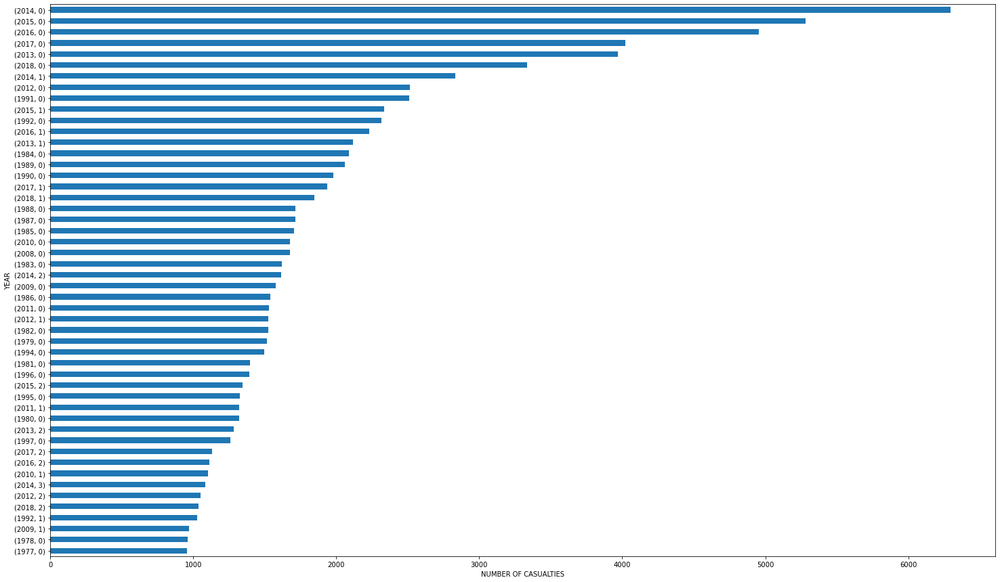

In [ ]:
plt.figure(figsize=(25,15))
df.groupby('iyear')['casualities'].value_counts().nlargest(50).sort_values(ascending=True).plot(kind='barh')
plt.ylabel('YEAR')
plt.xlabel('NUMBER OF CASUALTIES')
plt.show

### Values are sorted by the top 40 worst terror attacks as to keep the heatmap simple and easy to visualize


In [ ]:
terror1 = df.sort_values(by='casualities',ascending=False)[:40]
heat=terror1.pivot_table(index='country_txt',columns='iyear',values='casualities')
heat.fillna(0,inplace=True)

In [ ]:
heat.head()

iyear,1982,1984,1992,1994,1995,1996,1997,1998,2001,2004,2005,2006,2007,2008,2009,2014,2015,2016,2017
country_txt,,,,,,,,,,,,,,,,,,,
Afghanistan,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,536.0,0.0,584.0
Chad,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1161.0,0.0,0.0,0.0,0.0,0.0
Ethiopia,0.0,0.0,500.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
France,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,520.0,0.0
India,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1005.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [ ]:
# import plotly.offline as py
# py.init_notebook_mode(connected=True)
# import plotly.graph_objs as go

colorscale = [[0, '#edf8fb'], [.3, '#00BFFF'],  [.6, '#8856a7'],  [1, '#810f7c']]
heatmap = go.Heatmap(z=heat.values, x=heat.columns, y=heat.index, colorscale=colorscale)
data = [heatmap]
layout = go.Layout(
    title='Top 40 Worst Terror Attacks in History from 1982 to 2016',
    xaxis = dict(ticks='', nticks=20),
    yaxis = dict(ticks='')
)
fig = go.Figure(data=data, layout=layout)
py.iplot(fig, filename='heatmap',show_link=False)

### Top Countries affected by Terrorist Attacks

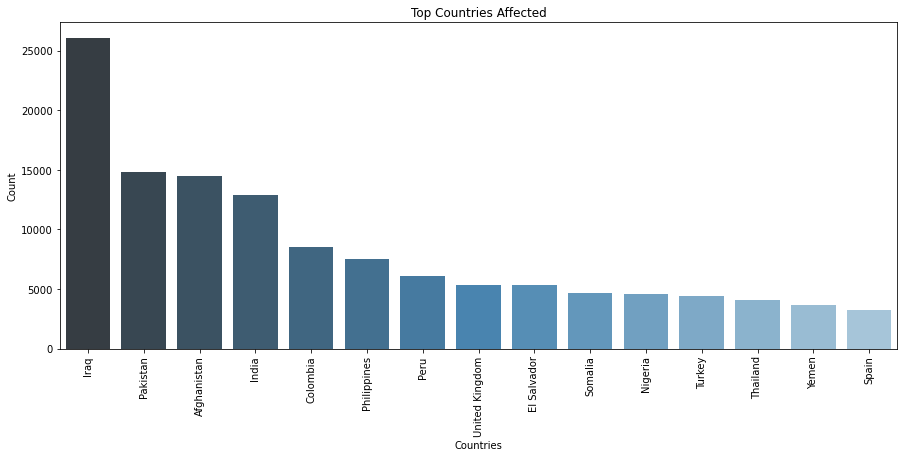

In [ ]:
plt.subplots(figsize=(15,6))
sns.barplot(df['country_txt'].value_counts()[:15].index,df['country_txt'].value_counts()[:15].values,palette='Blues_d')
plt.title('Top Countries Affected')
plt.xlabel('Countries')
plt.ylabel('Count')
plt.xticks(rotation= 90)
plt.show()

In [ ]:
# Total Number of people killed in terror attack
killData = df.loc[:,'nkill']
print('Number of people killed by terror attack:', int(sum(killData.dropna())))# drop the NaN values


Number of people killed by terror attack: 434981


In [ ]:
# Let's look at what types of attacks these deaths were made of.
attackData = df.loc[:,'attacktype1']
# attackData
typeKillData = pd.concat([attackData, killData], axis=1)

In [ ]:
typeKillFormatData = typeKillData.pivot_table(columns='attacktype1', values='nkill', aggfunc='sum')
typeKillFormatData

attacktype1,Armed assault,Assassination,Bombing/explosion,Facility/infrastructure attack,Hijacking,Hostage taking (barricade incident),Hostage taking (kidnapping),Unarmed assaults,Unknown
nkill,168294,25751,164166,4065,3726,4665,26794,896,36624


In [ ]:
#Number of Killed in Terrorist Attacks by Countries
countryData = df.loc[:,'country_txt']
# countyData
countryKillData = pd.concat([countryData, killData], axis=1)

In [ ]:
countryKillFormatData = countryKillData.pivot_table(columns='country_txt', values='nkill', aggfunc='sum')
countryKillFormatData

country_txt,Afghanistan,Albania,Algeria,Andorra,Angola,Antigua and Barbuda,Argentina,Armenia,Australia,Austria,Azerbaijan,Bahamas,Bahrain,Bangladesh,Barbados,Belarus,Belgium,Belize,Benin,Bhutan,Bolivia,Bosnia-Herzegovina,Botswana,Brazil,Brunei,Bulgaria,Burkina Faso,Burundi,Cambodia,Cameroon,Canada,Central African Republic,Chad,Chile,China,Colombia,Comoros,Costa Rica,Croatia,Cuba,Cyprus,Czech Republic,Czechoslovakia,Democratic Republic of the Congo,Denmark,Djibouti,Dominica,Dominican Republic,East Germany (GDR),East Timor,Ecuador,Egypt,El Salvador,Equatorial Guinea,Eritrea,Estonia,Ethiopia,Falkland Islands,Fiji,Finland,France,French Guiana,French Polynesia,Gabon,Gambia,Georgia,Germany,Ghana,Greece,Grenada,Guadeloupe,Guatemala,Guinea,Guinea-Bissau,Guyana,Haiti,Honduras,Hong Kong,Hungary,Iceland,India,Indonesia,International,Iran,Iraq,Ireland,Israel,Italy,Ivory Coast,Jamaica,Japan,Jordan,Kazakhstan,Kenya,Kosovo,Kuwait,Kyrgyzstan,Laos,Latvia,Lebanon,Lesotho,Liberia,Libya,Lithuania,Luxembourg,Macau,Macedonia,Madagascar,Malawi,Malaysia,Maldives,Mali,Malta,Martinique,Mauritania,Mauritius,Mexico,Moldova,Montenegro,Morocco,Mozambique,Myanmar,Namibia,Nepal,Netherlands,New Caledonia,New Hebrides,New Zealand,Nicaragua,Niger,Nigeria,North Korea,North Yemen,Norway,Pakistan,Panama,Papua New Guinea,Paraguay,People's Republic of the Congo,Peru,Philippines,Poland,Portugal,Qatar,Republic of the Congo,Rhodesia,Romania,Russia,Rwanda,Saudi Arabia,Senegal,Serbia,Serbia-Montenegro,Seychelles,Sierra Leone,Singapore,Slovak Republic,Slovenia,Solomon Islands,Somalia,South Africa,South Korea,South Sudan,South Vietnam,South Yemen,Soviet Union,Spain,Sri Lanka,St. Kitts and Nevis,St. Lucia,Sudan,Suriname,Swaziland,Sweden,Switzerland,Syria,Taiwan,Tajikistan,Tanzania,Thailand,Togo,Trinidad and Tobago,Tunisia,Turkey,Turkmenistan,Uganda,Ukraine,United Arab Emirates,United Kingdom,United States,Uruguay,Uzbekistan,Vanuatu,Vatican City,Venezuela,Vietnam,Wallis and Futuna,West Bank and Gaza Strip,West Germany (FRG),Western Sahara,Yemen,Yugoslavia,Zaire,Zambia,Zimbabwe
nkill,49202,42,11084,0,3043,0,490,37,25,31,258,1,44,1257,76,14,83,3,0,9,54,79,11,213,0,28,250,4241,543,2659,378,2217,1231,228,1010,14830,1,17,248,8,45,6,27,5062,5,274,3,34,2,9,63,3968,12053,2,46,3,1790,0,8,11,547,1,0,6,13,279,84,21,263,9,8,5167,214,17,41,336,307,4,6,0,19753,1309,1,1739,80160,108,1626,420,270,42,66,136,39,2009,84,63,11,27,2,4064,46,177,2843,1,0,1,49,31,33,155,20,2018,5,0,43,0,803,13,2,294,2849,1316,220,1969,37,35,0,1,10607,1549,25258,3,3,79,24520,38,79,61,15,12777,10000,9,32,7,182,217,4,4331,3248,689,340,3,3,0,840,5,9,1,4,11427,2698,10,2731,81,0,96,1289,15533,0,2,3925,29,6,22,74,16777,60,340,82,2811,76,6,371,6984,3,3082,2276,123,3411,3836,6,68,0,0,259,1,0,1630,97,1,9607,119,324,70,156


In [ ]:
fig_size = plt.rcParams["figure.figsize"]
fig_size[0]=25
fig_size[1]=25
plt.rcParams["figure.figsize"] = fig_size

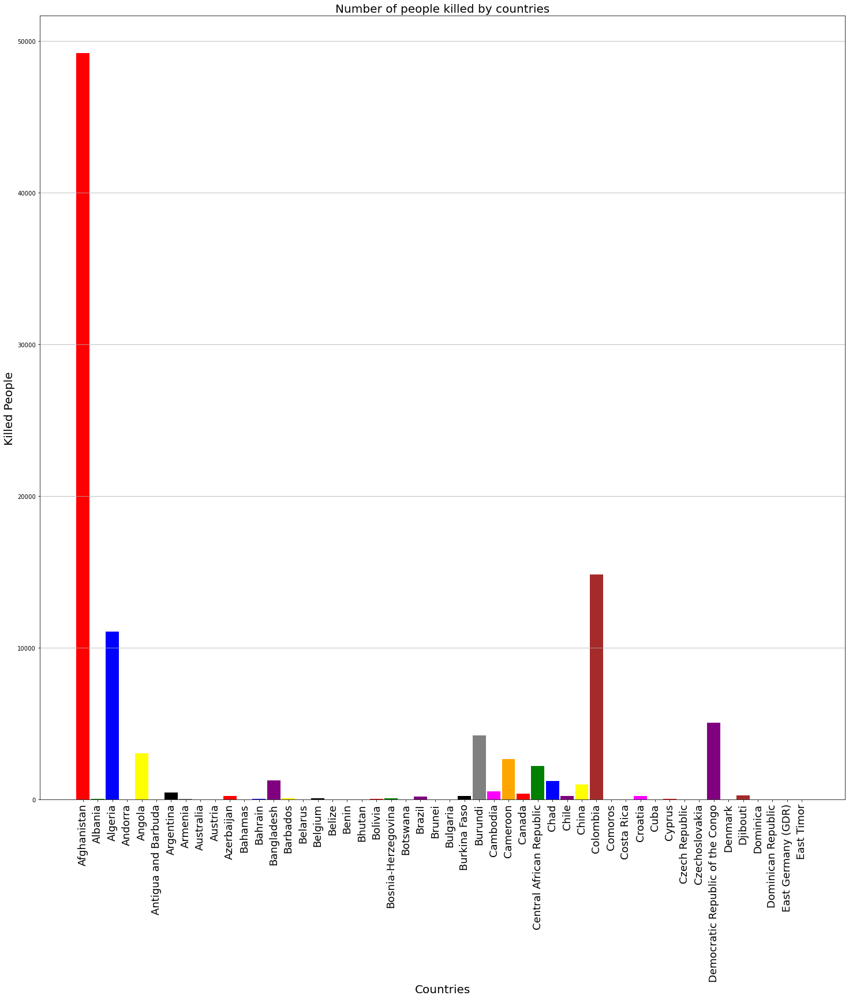

In [ ]:
labels = countryKillFormatData.columns.tolist()
labels = labels[:50] #50 bar provides nice view
index = np.arange(len(labels))
transpoze = countryKillFormatData.T
values = transpoze.values.tolist()
values = values[:50]
values = [int(i[0]) for i in values] # convert float to int
colors = ['red', 'green', 'blue', 'purple', 'yellow', 'brown', 'black', 'gray', 'magenta', 'orange'] # color list for bar chart bar color 
fig, ax = plt.subplots(1, 1)
ax.yaxis.grid(True)
fig_size = plt.rcParams["figure.figsize"]
fig_size[0]=25
fig_size[1]=25
plt.rcParams["figure.figsize"] = fig_size
plt.bar(index, values, color = colors, width = 0.9)
plt.ylabel('Killed People', fontsize=20)
plt.xlabel('Countries', fontsize = 20)
plt.xticks(index, labels, fontsize=18, rotation=90)
plt.title('Number of people killed by countries', fontsize = 20)
# print(fig_size)
plt.show()

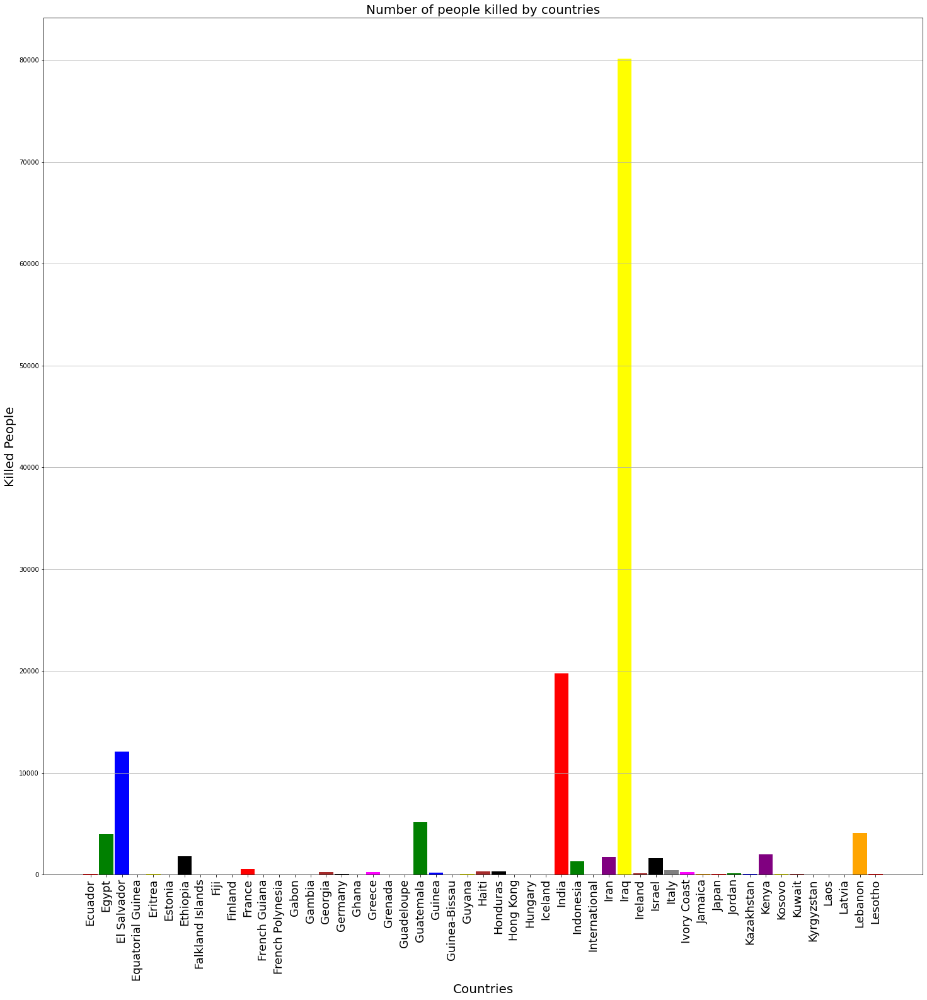

In [ ]:
labels = countryKillFormatData.columns.tolist()
labels = labels[50:101]
index = np.arange(len(labels))
transpoze = countryKillFormatData.T
values = transpoze.values.tolist()
values = values[50:101]
values = [int(i[0]) for i in values]
colors = ['red', 'green', 'blue', 'purple', 'yellow', 'brown', 'black', 'gray', 'magenta', 'orange']
fig, ax = plt.subplots(1, 1)
ax.yaxis.grid(True)
fig_size = plt.rcParams["figure.figsize"]
fig_size[0]=20
fig_size[1]=20
plt.rcParams["figure.figsize"] = fig_size
plt.bar(index, values, color = colors, width = 0.9)
plt.ylabel('Killed People', fontsize=20)
plt.xlabel('Countries', fontsize = 20)
plt.xticks(index, labels, fontsize=18, rotation=90)
plt.title('Number of people killed by countries', fontsize = 20)
plt.show()

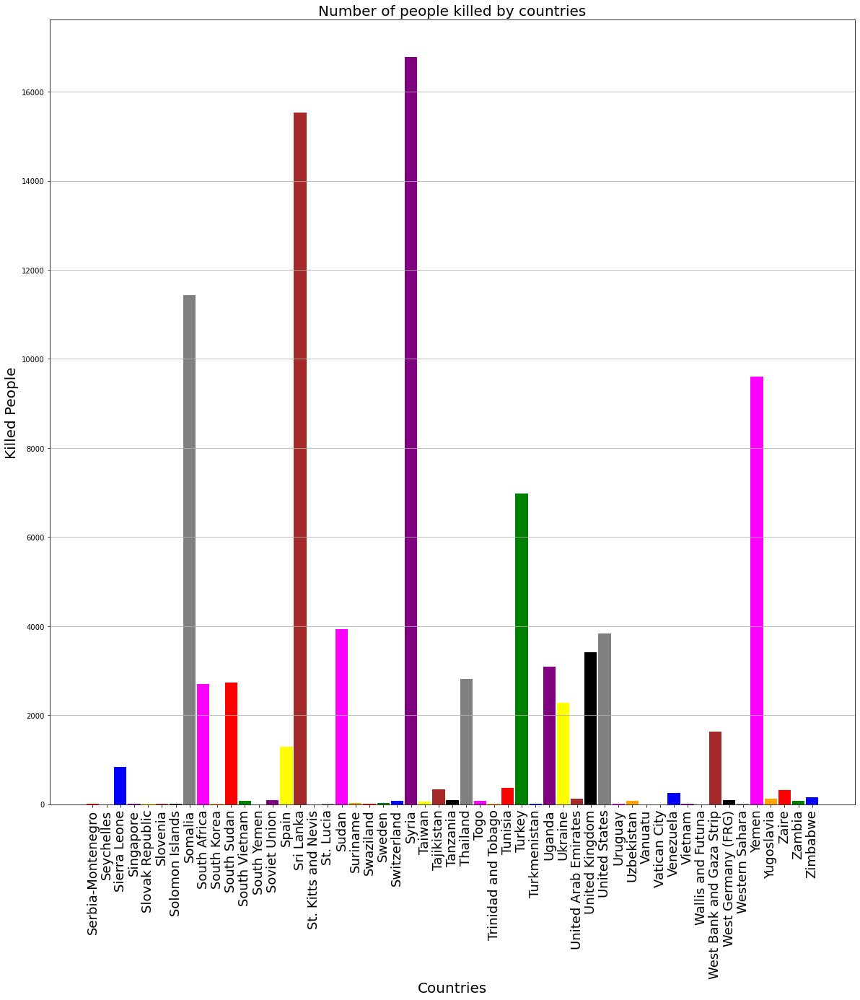

In [ ]:
labels = countryKillFormatData.columns.tolist()
labels = labels[152:206]
index = np.arange(len(labels))
transpoze = countryKillFormatData.T
values = transpoze.values.tolist()
values = values[152:206]
values = [int(i[0]) for i in values]
colors = ['red', 'green', 'blue', 'purple', 'yellow', 'brown', 'black', 'gray', 'magenta', 'orange']
fig, ax = plt.subplots(1, 1)
ax.yaxis.grid(True)
fig_size = plt.rcParams["figure.figsize"]
fig_size[0]=25
fig_size[1]=25
plt.rcParams["figure.figsize"] = fig_size
plt.bar(index, values, color = colors, width = 0.9)
plt.ylabel('Killed People', fontsize=20)
plt.xlabel('Countries', fontsize = 20)
plt.xticks(index, labels, fontsize=18, rotation=90)
plt.title('Number of people killed by countries', fontsize = 20)
plt.show()


**Terrorist acts in the Middle East and northern Africa have been seen to have fatal consequences. The Middle East and North Africa are seen to be the places of serious terrorist attacks. In addition, even though there is a perception that Muslims are supporters of terrorism, Muslims are the people who are most damaged by terrorist attacks. If you look at the graphics, it appears that Iraq, Afghanistan and Pakistan are the most damaged countries. All of these countries are Muslim countries.**
